
#**Ejercicios Unidad 1**


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np
import requests
from io import BytesIO

In [ ]:
!pip install -q mediapy
import mediapy as media

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 24.2 MB/s eta 0:00:00


In [ ]:
%%capture
# Instalar la biblioteca pytube
!pip install pytube
!apt update && apt install -y handbrake

from pytube import YouTube

In [ ]:
%pip install ultralytics
# Librería mediapy para mostrar videos
%pip install -q mediapy
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 28.9/107.7 GB disk)


In [ ]:
from ultralytics import YOLO

#8
En lo posible, realizar videos donde una clase de objeto difiera en número con otros objetos (sino, utilizar videos bajados de internet). Por ejemplo, al aire libre, un perro que se mueva entre personas en un parque. Una persona en bicicleta entre muchos autos en una calle de la ciudad. Luego, utilizar los distintos algoritmos presentados en teoría para detectar solo la clase minoritaria con su respectiva etiqueta. Indicando en cada caso la herramienta utilizada y comparando los niveles de confianza de detección logrados.

In [ ]:
# Run inference on an image with YOLOv8n
!yolo predict model=yolov8n.pt source='https://ultralytics.com/images/zidane.jpg'
from IPython.display import Image
#Image('runs/detect/predict/zidane.jpg')

100% 6.23M/6.23M [00:00<00:00, 65.0MB/s]
Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients, 8.7 GFLOPs

100% 165k/165k [00:00<00:00, 7.02MB/s]
image 1/1 /content/zidane.jpg: 384x640 2 persons, 1 tie, 726.4ms
Speed: 18.1ms preprocess, 726.4ms inference, 7548.1ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


In [ ]:
# Load the pre-trained YOLOv8 model
model = YOLO('yolov8n')  # This will automatically download the model weights

# Función para detectar objetos en una imagen:
def detect_objects(new_image, prev_image, **kwargs):
    # Convertir la imagen a float32
    results = model(new_image)

    # Clases de interés para graficar
    classes = kwargs.get('classes', ['car', 'person', 'bus'])

    # Iteramos sobre los boung boxes obtenidos
    for box in results[0].boxes:
        # Extrayendo los datos del tensor
        x1, y1, x2, y2, confidence, cls = box.data[0]

        # Obteniendo el nombre de la clase
        class_name = model.names[int(cls)]

        # Parámetros opcionales del bounding box
        color = kwargs.get('color', (0, 255, 0))
        thickness = kwargs.get('thickness', 2)

        if class_name in classes:
            # Dibujar el rectángulo
            cv2.rectangle(new_image, (int(x1), int(y1)), (int(x2), int(y2)), color, thickness)

            # Agregar el texto de la confianza
            confidence_text = f"{class_name}: {confidence:.2f}"
            cv2.putText(new_image, confidence_text, (int(x1), int(y1)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    return new_image

# Función para procesar un video:
def video_processor(filename_in, filename_out, process_func, max_time=10, **kwargs):
    # Abrir el video de entrada para lectura
    with media.VideoReader(filename_in) as r:
        # Crear un archivo de video de salida
        with media.VideoWriter(filename_out, shape=r.shape, fps=r.fps, bps=r.bps) as w:
            count = 0  # Inicializar contador de fotogramas
            prev_image = None  # Inicializar la imagen previa

            # Iterar sobre cada imagen (fotograma) del video
            for image in r:
                new_image = media.to_uint8(image)  # Convertir la imagen a formato flotante

                # Comprobar si es la primera imagen
                if prev_image is None:
                    prev_image = new_image.copy()

                # Procesar la imagen utilizando la función dada
                processed_image = process_func(new_image, prev_image, **kwargs)

                # Añadir la imagen procesada al video de salida
                w.add_image(processed_image)

                # Actualizar la imagen previa
                prev_image = new_image.copy()

                # Incrementar el contador de fotogramas
                count += 1

                # Detener el proceso si se alcanza el tiempo máximo
                if count >= max_time * r.fps:
                    break

# Nombres de los archivos de video de entrada y salida
filename_in = '3630-172488409_small.mp4'
filename_out = '3630-172488409_small_bboxes.mp4'
parameters = dict(classes=['person', 'car'])    # ['car', 'person', 'bus']

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, detect_objects, 20, **parameters)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)


0: 384x640 7 persons, 3 cars, 2 buss, 206.4ms
Speed: 3.7ms preprocess, 206.4ms inference, 2307.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 persons, 3 cars, 2 buss, 154.1ms
Speed: 5.3ms preprocess, 154.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 9 persons, 3 cars, 3 buss, 149.8ms
Speed: 5.0ms preprocess, 149.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 7 persons, 3 cars, 3 buss, 177.1ms
Speed: 4.0ms preprocess, 177.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 8 persons, 3 cars, 3 buss, 1 traffic light, 146.8ms
Speed: 5.0ms preprocess, 146.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 9 persons, 3 cars, 2 buss, 2 traffic lights, 160.2ms
Speed: 4.2ms preprocess, 160.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 9 persons, 3 cars, 2 buss, 1 traffic light, 145.0ms
Speed: 3.4ms preprocess, 145

El algoritmo tiene ciertas deficiencias en la detección.

#9
Tomar fotografías donde coexistan varios objetos en posiciones solapadas y no, en contextos de diferente complejidad. Luego, aplicar los algoritmos de segmentación propuestos y verificar los resultados de cada uno. Comentar qué diferencias observa.

In [ ]:
import cv2
import numpy as np
import requests
from io import BytesIO

# URL de la imagen
image_url = "https://raw.githubusercontent.com/sofiarondini/ComputerVisionSofiaRondini/main/20240425_134408.jpg"

# Descargar la imagen desde la URL
response = requests.get(image_url)
image_bytes = BytesIO(response.content)

# Leer la imagen desde la memoria
image = cv2.imdecode(np.frombuffer(image_bytes.read(), np.uint8), -1)


In [ ]:
%%capture
!wget http://download.tensorflow.org/models/object_detection/mask_rcnn_inception_v2_coco_2018_01_28.tar.gz
!tar zxvf mask_rcnn_inception_v2_coco_2018_01_28.tar.gz
!wget https://raw.githubusercontent.com/spmallick/learnopencv/master/Mask-RCNN/mscoco_labels.names -O mscoco_labels.names
!wget https://raw.githubusercontent.com/spmallick/learnopencv/master/Mask-RCNN/colors.txt -O colors.txt
!wget https://raw.githubusercontent.com/spmallick/learnopencv/master/Mask-RCNN/mask_rcnn_inception_v2_coco_2018_01_28.pbtxt -O mask_rcnn_inception_v2_coco_2018_01_28.pbtxt
!wget https://raw.githubusercontent.com/matterport/Mask_RCNN/master/images/7933423348_c30bd9bd4e_z.jpg -O police_motorbike.jpg

In [ ]:
import time
import random
import cv2 as cv
from matplotlib import pyplot as plt

# Umbral de confianza para las detecciones
confThreshold = 0.5
# Umbral para las máscaras de segmentación
maskThreshold = 0.3

# Cargar los nombres de las clases de MSCOCO
classesFile = "mscoco_labels.names"
classes = None
with open(classesFile, 'rt') as f:
    classes = f.read().rstrip('\n').split('\n')

# Cargar los colores para visualizar las detecciones
colorsFile = "colors.txt"
colors = []
with open(colorsFile, 'rt') as f:
    colorsStr = f.read().rstrip('\n').split('\n')
    for i in range(len(colorsStr)):
        rgb = colorsStr[i].split(' ')
        color = np.array([float(rgb[0]), float(rgb[1]), float(rgb[2])])
        colors.append(color)

# Archivos de configuración y pesos del modelo Mask R-CNN
textGraph = "./mask_rcnn_inception_v2_coco_2018_01_28.pbtxt"
modelWeights = "./mask_rcnn_inception_v2_coco_2018_01_28/frozen_inference_graph.pb"

# Cargar la red
net = cv.dnn.readNetFromTensorflow(modelWeights, textGraph)
net.setPreferableBackend(cv.dnn.DNN_BACKEND_OPENCV)
net.setPreferableTarget(cv.dnn.DNN_TARGET_CPU)

# Cargar la imagen y obtener sus dimensiones
image = cv.imread(image)
(H, W) = image.shape[:2]

# Crear un blob de la imagen y realizar una pasada hacia adelante con Mask R-CNN
blob = cv.dnn.blobFromImage(image, swapRB=True, crop=False)
net.setInput(blob)
start = time.time()
(boxes, masks) = net.forward(["detection_out_final", "detection_masks"])
end = time.time()

# Información de tiempo y formas de las detecciones y máscaras
print("[INFO] Mask R-CNN tomó {:.6f} segundos en procesar la imagen".format(end - start))
print("[INFO] Forma de boxes: {}".format(boxes.shape))
print("[INFO] Forma de masks: {}".format(masks.shape))

[INFO] Mask R-CNN tomó 24.506705 segundos en procesar la imagen
[INFO] Forma de boxes: (1, 1, 100, 7)
[INFO] Forma de masks: (100, 90, 15, 15)


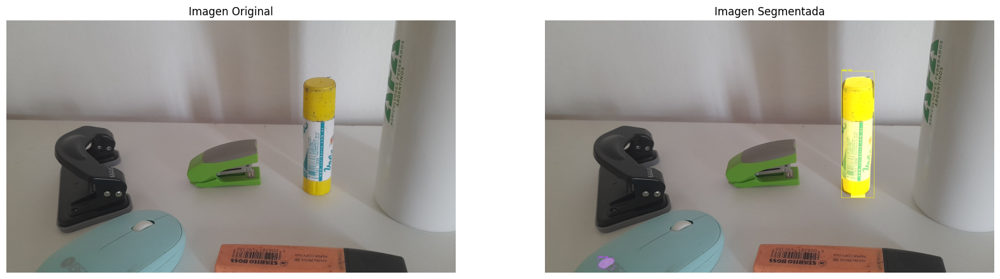

In [ ]:
# Creamos una copia de la imagen original, para dibujar las máscaras
output_image = image.copy()

for i in range(0, boxes.shape[2]):
    confidence = boxes[0, 0, i, 2]
    if confidence > confThreshold:
        classId = int(boxes[0, 0, i, 1])
        box = boxes[0, 0, i, 3:7] * np.array([W, H, W, H])
        (startX, startY, endX, endY) = box.astype("int")

        # Redimensiona la máscara para que se ajuste a la caja delimitadora y la convierte en uint8
        mask = masks[i, classId]
        mask = cv.resize(mask, (endX - startX, endY - startY))
        mask = (mask > maskThreshold).astype("uint8")

        # Extrae la región de interés (ROI) usando las coordenadas de la caja delimitadora
        roi = output_image[startY:endY, startX:endX]

        # Crea una imagen de color sólido para la máscara
        color = random.choice(colors)
        color_mask = np.zeros_like(roi)
        color_mask[mask == 1] = color

        # Mezcla la imagen de color con la ROI utilizando la máscara
        roi = cv.addWeighted(roi, 1, color_mask, 0.4, 0)

        # Vuelve a colocar la ROI en la imagen original
        output_image[startY:endY, startX:endX] = roi

        # Dibuja la caja delimitadora
        cv.rectangle(output_image, (startX, startY), (endX, endY), color, 2)

        # Consigue el nombre de la clase y el color correspondiente
        classId = int(boxes[0, 0, i, 1])
        className = classes[classId]

        # Dibuja el rectángulo de la caja delimitadora y la etiqueta de la clase
        label = f"{className}: {confidence:.2f}"
        cv.rectangle(output_image, (startX, startY), (endX, endY), color, 2)
        cv.putText(output_image, label, (startX, startY - 5), cv.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)


# Configurar los subplots
fig, axes = plt.subplots(1, 2, figsize=(20, 10))

# Mostrar la imagen original
axes[0].imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))
axes[0].set_title('Imagen Original')
axes[0].axis('off')  # Ocultar los ejes

# Mostrar la imagen segmentada
axes[1].imshow(cv.cvtColor(output_image, cv.COLOR_BGR2RGB))
axes[1].set_title('Imagen Segmentada')
axes[1].axis('off')  # Ocultar los ejes

# Mostrar ambas imágenes
plt.show()


Reconoce solamente 1 objeto

In [ ]:
%%capture
!pip install pixellib torchvision
# Instance segmentation model
!wget "https://github.com/ayoolaolafenwa/PixelLib/releases/download/0.2.0/pointrend_resnet50.pkl" -O pointrend_resnet50.pkl

  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


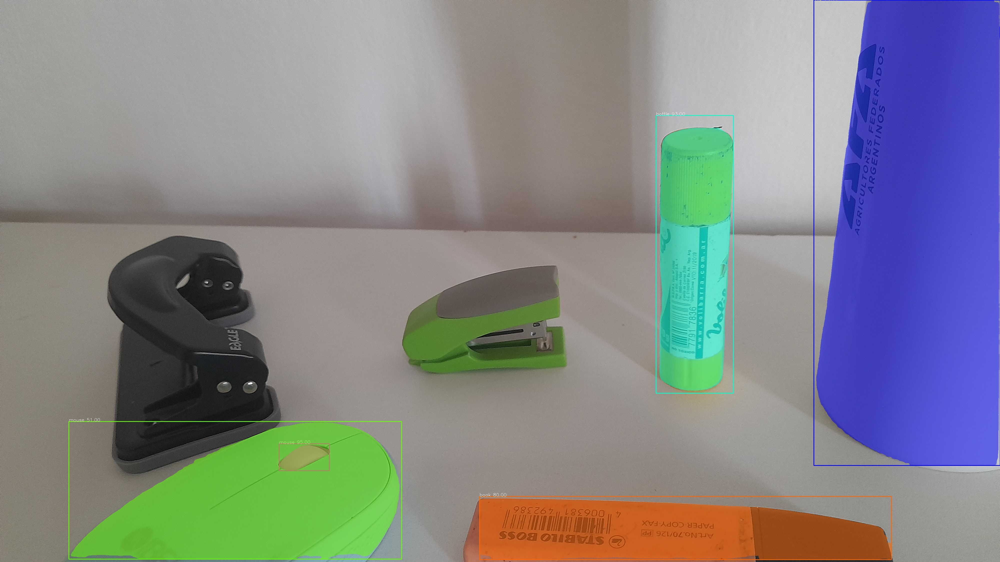

In [ ]:
import cv2
import numpy as np
import requests
from io import BytesIO
from PIL import Image
import pixellib
from pixellib.torchbackend.instance import instanceSegmentation


# URL de la imagen
image_url = "https://raw.githubusercontent.com/sofiarondini/ComputerVisionSofiaRondini/main/20240425_134408.jpg"

# Descargar la imagen desde la URL
response = requests.get(image_url)
image_bytes = BytesIO(response.content)

# Leer la imagen desde la memoria
image = cv2.imdecode(np.frombuffer(image_bytes.read(), np.uint8), -1)

# Guardar la imagen en un archivo temporal
temp_image_path = "temp_image.jpg"
cv2.imwrite(temp_image_path, image)

# Creación de una instancia del modelo de segmentación
ins = instanceSegmentation()

# Carga del modelo preentrenado
ins.load_model("pointrend_resnet50.pkl")

# Segmentación de la imagen y guardado de la imagen segmentada con las cajas delimitadoras
ins.segmentImage(temp_image_path, show_bboxes=True, output_image_name="20240425_134408_segmented.jpg")

# Muestra la imagen original
Image.open(BytesIO(response.content))

# Muestra la imagen segmentada
Image.open("20240425_134408_segmented.jpg")

Reconoce 4 objetos

  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


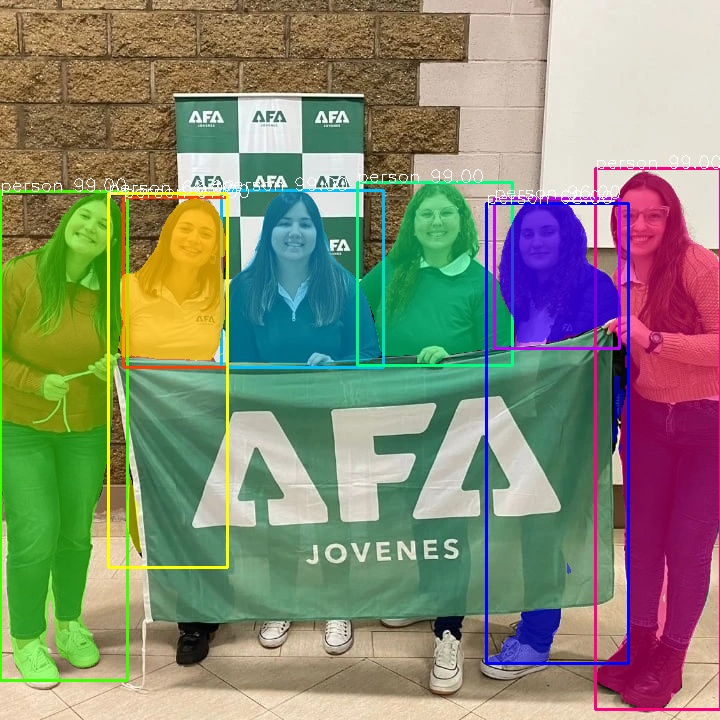

In [ ]:
import cv2
import numpy as np
import requests
from io import BytesIO
from PIL import Image
import pixellib
from pixellib.torchbackend.instance import instanceSegmentation


# URL de la imagen
image_url = "https://raw.githubusercontent.com/sofiarondini/ComputerVisionSofiaRondini/main/IMG_20240316_164316_733.jpg"

# Descargar la imagen desde la URL
response = requests.get(image_url)
image_bytes = BytesIO(response.content)

# Leer la imagen desde la memoria
image = cv2.imdecode(np.frombuffer(image_bytes.read(), np.uint8), -1)

# Guardar la imagen en un archivo temporal
temp_image_path = "temp_image.jpg"
cv2.imwrite(temp_image_path, image)

# Creación de una instancia del modelo de segmentación
ins = instanceSegmentation()

# Carga del modelo preentrenado
ins.load_model("pointrend_resnet50.pkl")

# Segmentación de la imagen y guardado de la imagen segmentada con las cajas delimitadoras
ins.segmentImage(temp_image_path, show_bboxes=True, output_image_name="20240425_134408_segmented.jpg")

# Muestra la imagen original
Image.open(BytesIO(response.content))

# Muestra la imagen segmentada
Image.open("20240425_134408_segmented.jpg")

In [ ]:
%%capture
!pip install torchvision
import torch
model = torch.hub.load('pytorch/vision:v0.10.0', 'deeplabv3_resnet50', pretrained=True)
model.eval()

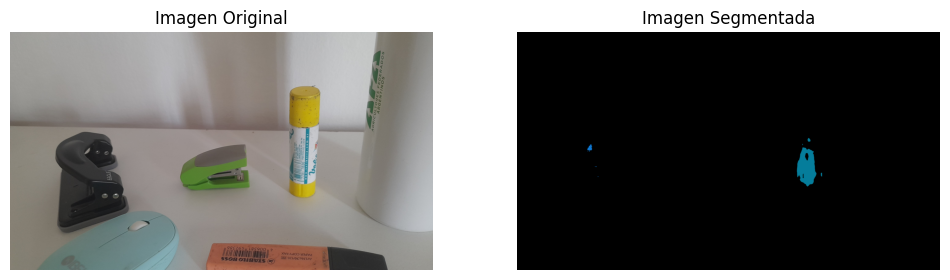

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Carga y procesa la imagen
input_image = Image.open("20240425_134408.jpg").convert("RGB").convert("RGB")

preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

input_tensor = preprocess(input_image)
input_batch = input_tensor.unsqueeze(0)  # crea un mini-batch como espera el modelo

# Mueve el input y el modelo a GPU para mayor velocidad si está disponible
if torch.cuda.is_available():
    input_batch = input_batch.to('cuda')
    model.to('cuda')

with torch.no_grad():
    output = model(input_batch)['out'][0]
output_predictions = output.argmax(0)

# Crea una paleta de colores, seleccionando un color para cada clase
palette = torch.tensor([2 ** 25 - 1, 2 ** 15 - 1, 2 ** 21 - 1])
colors = torch.as_tensor([i for i in range(21)])[:, None] * palette
colors = (colors % 255).numpy().astype("uint8")

# Genera la imagen de segmentación semántica
r = Image.fromarray(output_predictions.byte().cpu().numpy()).resize(input_image.size)
r.putpalette(colors)

# Muestra la imagen original y la segmentada lado a lado
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)  # 1 fila, 2 columnas, primer subplot
plt.imshow(input_image)
plt.title('Imagen Original')
plt.axis('off')  # Oculta los ejes

plt.subplot(1, 2, 2)  # 1 fila, 2 columnas, segundo subplot
plt.imshow(r)
plt.title('Imagen Segmentada')
plt.axis('off')  # Oculta los ejes

plt.show()

No reconoce ningun objeto bien

#10
Con el mismo video usado en el ejercicio 4, realice un seguimiento de objetos con el código propuesto en la sección de ejemplos prácticos.

In [ ]:
import mediapy as media  # Importar la biblioteca mediapy para manejo de medios
import cv2  # Importar OpenCV para el procesamiento de imágenes y videos
import numpy as np
from ultralytics import YOLO

# Load the pre-trained YOLOv8 model
model = YOLO('yolov8n')  # This will automatically download the model weights

# Función para detectar objetos en una imagen:
def detect_objects(new_image, prev_image, **kwargs):
    # Convertir la imagen a float32
    results = model(new_image)

    # Clases de interés para graficar
    classes = kwargs.get('classes', ['marble'])

    # Iteramos sobre los boung boxes obtenidos
    for box in results[0].boxes:
        # Extrayendo los datos del tensor
        x1, y1, x2, y2, confidence, cls = box.data[0]

        # Obteniendo el nombre de la clase
        class_name = model.names[int(cls)]

        # Parámetros opcionales del bounding box
        color = kwargs.get('color', (0, 255, 0))
        thickness = kwargs.get('thickness', 2)

        if class_name in classes:
            # Dibujar el rectángulo
            cv2.rectangle(new_image, (int(x1), int(y1)), (int(x2), int(y2)), color, thickness)

            # Agregar el texto de la confianza
            confidence_text = f"{class_name}: {confidence:.2f}"
            cv2.putText(new_image, confidence_text, (int(x1), int(y1)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    return new_image

# Función para procesar un video:
def video_processor(filename_in, filename_out, process_func, max_time=10, **kwargs):
    # Abrir el video de entrada para lectura
    with media.VideoReader(filename_in) as r:
        # Crear un archivo de video de salida
        with media.VideoWriter(filename_out, shape=r.shape, fps=r.fps, bps=r.bps) as w:
            count = 0  # Inicializar contador de fotogramas
            prev_image = None  # Inicializar la imagen previa

            # Iterar sobre cada imagen (fotograma) del video
            for image in r:
                new_image = media.to_uint8(image)  # Convertir la imagen a formato flotante

                # Comprobar si es la primera imagen
                if prev_image is None:
                    prev_image = new_image.copy()

                # Procesar la imagen utilizando la función dada
                processed_image = process_func(new_image, prev_image, **kwargs)

                # Añadir la imagen procesada al video de salida
                w.add_image(processed_image)

                # Actualizar la imagen previa
                prev_image = new_image.copy()

                # Incrementar el contador de fotogramas
                count += 1

                # Detener el proceso si se alcanza el tiempo máximo
                if count >= max_time * r.fps:
                    break

# Nombres de los archivos de video de entrada y salida
filename_in = 'highway_recortado.mp4'
filename_out = 'highway_recortado_bboxes.mp4'
parameters = dict(classes=['marble'])

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, detect_objects, 20, **parameters)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)


0: 384x640 1 person, 1 scissors, 188.6ms
Speed: 3.7ms preprocess, 188.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 scissors, 166.4ms
Speed: 2.7ms preprocess, 166.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 scissors, 147.8ms
Speed: 6.6ms preprocess, 147.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 scissors, 150.0ms
Speed: 3.3ms preprocess, 150.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 scissors, 147.8ms
Speed: 2.4ms preprocess, 147.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 scissors, 145.5ms
Speed: 3.6ms preprocess, 145.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 scissors, 148.1ms
Speed: 2.7ms preprocess, 148.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 scissors, 172.7ms
Speed: 2.7ms preprocess, 172

No se como poner que detecte las canicas

#11
Tome fotos donde se vea su rostro y el de varias personas. Asegúrese de tener fotos que tengan uno, dos y más caras diferentes. Implemente la librería OpenCV para la detección de rostros en ambos casos. Analice paso a paso el código que permite la detección de elementos de un rostro.

In [ ]:
%%capture
# Image de prueba
!wget --no-check-certificate https://raw.githubusercontent.com/jpmanson/tuia-unr/main/images/face_test.jpg -O face_test.jpg

In [ ]:
import cv2
import numpy as np
import requests
from io import BytesIO

# URL de la imagen
image_url = "https://raw.githubusercontent.com/sofiarondini/ComputerVisionSofiaRondini/main/IMG_20240316_164316_733.jpg"

# Descargar la imagen desde la URL
response = requests.get(image_url)
image_bytes = BytesIO(response.content)

# Leer la imagen desde la memoria
image = cv2.imdecode(np.frombuffer(image_bytes.read(), np.uint8), -1)


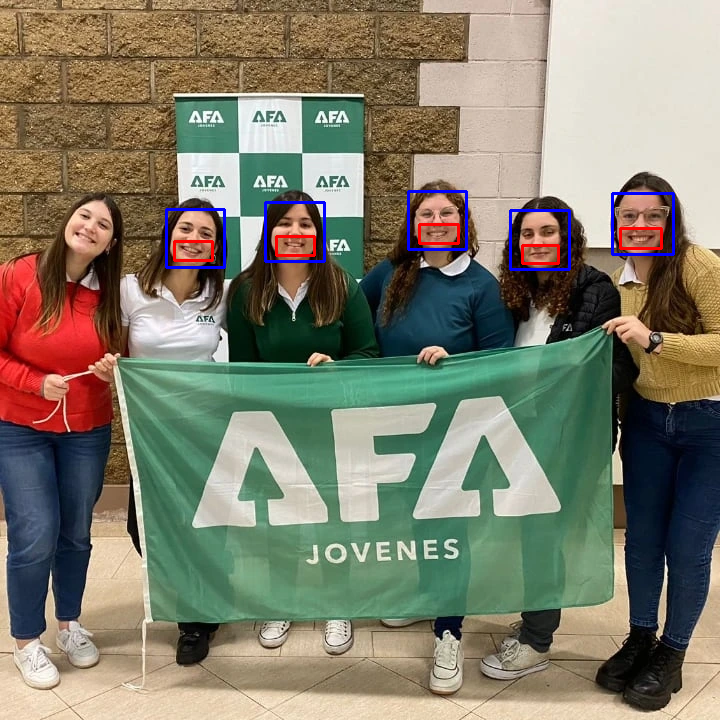

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Cargar los clasificadores preentrenados
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')
smile_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_smile.xml')

# Convertirla a escala de grises
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Detectar rostros en la imagen
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x,y,w,h) in faces:
    cv2.rectangle(image,(x,y),(x+w,y+h),(255,0,0),2)
    roi_gray = gray[y:y+h, x:x+w]
    roi_color = image[y:y+h, x:x+w]

    # Detectar ojos dentro del área del rostro
    eyes = eye_cascade.detectMultiScale(roi_gray)
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(0,255,0),2)

    # Detectar sonrisa dentro del área del rostro
    mouth = smile_cascade.detectMultiScale(roi_gray)
    for (mx,my,mw,mh) in mouth:
        cv2.rectangle(roi_color,(mx,my),(mx+mw,my+mh),(0,0,255),2)

# Mostrar la imagen resultante
cv2_imshow(image)


Reconoce 5 de 6 rostros

#12
Tome fotos donde sólo se vea un rostro (suyo o de otras personas) desde distintos ángulos y en distintas posturas. Luego, utilizando la librería DeepFace verifique, comparando dichas fotos, si los rostros corresponden a la misma persona o no.

#13
Experimente creando un programa que reemplace caras por un emoji que corresponda a la expresión de la cara en cuestión.  Analice si puede realizarlo en tiempo real.